# Proyecto: Innovación Tecnológica en Bodoque Bank

**MDS7202: Laboratorio de Programación Científica para Ciencia de Datos**

### Cuerpo Docente:

- Profesor: Pablo Badilla, Ignacio Meza De La Jara
- Auxiliar: Sebastián Tinoco
- Ayudante: Diego Cortez M., Felipe Arias T.

*Por favor, lean detalladamente las instrucciones de la tarea antes de empezar a escribir.*


----

## Reglas

- Fecha de entrega: 01/06/2021
- **Grupos de 2 personas.**
- Cualquier duda fuera del horario de clases al foro. Mensajes al equipo docente serán respondidos por este medio.
- Estrictamente prohibida la copia. 
- Pueden usar cualquier material del curso que estimen conveniente.



# Proyecto

### Estudiante: Vicente Bórquez Z



### Link de repositorio de GitHub: `\<http://....\>`




## 1. Introducción


Antes de abordar el proyecto como tal es importante entender el problema planteado: Se busca podr identificar clientes fraudulentos en base a sus actividades. 

Para ello se cuenta con 3 datasets que contienen información de actividades bancarias de clientes.

Para realizar este proyecto (al menos en el alcance de este documento) los pasos a seguir son:

1. Cargar los datos, unificarlos y tratar datos faltantes y duplicados
2. Realizar el análisis exploratorio de los datos, estudiar variables, compararlas entre sí y buscar así entender mejor los datos.
3. Manipular los datos para generar características que después un modelo pueda usar.
4. Visualizar los datos en baja dimensionalidad.
5. Implementar el detector de anomalías o fraudes.

In [1]:
import pandas as pd
import os
import missingno as msno
import matplotlib.pyplot as plt

import seaborn as sns

PATH_DATA = 'datos_proyecto_1'

## 2. Lectura y Manejo de Datos




### 2.1 Cargar datos en dataframes

El código para cargar los datos es directo, solamente hay que notar que el tipo de datos es `.parquet` y luego usar la función de pandas correcta.

In [2]:
df1 = pd.read_parquet(os.path.join(PATH_DATA, 'df_1.parquet'))
df2 = pd.read_parquet(os.path.join(PATH_DATA, 'df_2.parquet'))
df_email_phone = pd.read_parquet(os.path.join(PATH_DATA, 'df_email_phone.parquet'))

### 2.2 Exploración inicial

#### Primero una vista de las primeras 5 filas de cada dataframe

In [3]:
df1.head()

,id,fraud_bool,income,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,proposed_credit_limit,foreign_request,source,session_length_in_minutes,device_os,keep_alive_session,device_fraud_count,month,x1,x2
104446,729517,0,0.7,-1,305,60,0.030059,-1.599455,AC,990,...,500.0,0,INTERNET,8.865992,windows,0,0,2,-0.245425,0.568811
269483,149585,0,0.8,-1,140,50,0.015659,3.951994,AA,1269,...,200.0,0,INTERNET,4.654872,linux,1,0,7,0.009336,-2.096682
4102,64486,0,0.9,-1,171,50,0.001409,28.159779,AB,4430,...,1500.0,0,INTERNET,3.720953,linux,1,0,1,2.229616,-0.005823
351767,825283,0,0.5,-1,85,30,0.027292,-1.310498,AB,1698,...,200.0,0,INTERNET,2.912670,windows,1,0,3,-0.193945,0.861207
126377,8308,0,0.9,-1,39,30,0.010945,-1.450972,AC,569,...,200.0,0,INTERNET,2.283680,other,1,0,3,-2.440650,0.354986


In [4]:
df1.head().T

,104446,269483,4102,351767,126377
id,729517,149585,64486,825283,8308
fraud_bool,0,0,0,0,0
income,0.7,0.8,0.9,0.5,0.9
prev_address_months_count,-1,-1,-1,-1,-1
current_address_months_count,305,140,171,85,39
customer_age,60,50,50,30,30
days_since_request,0.030059,0.015659,0.001409,0.027292,0.010945
intended_balcon_amount,-1.599455,3.951994,28.159779,-1.310498,-1.450972
payment_type,AC,AA,AB,AB,AC
zip_count_4w,990,1269,4430,1698,569


In [5]:
df2.head()

,id,fraud_bool,income,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,proposed_credit_limit,foreign_request,source,session_length_in_minutes,device_os,keep_alive_session,device_fraud_count,month,x1,x2
699954,303612,0,0.8,-1,21,40,0.010837,-0.853976,AD,239,...,200.0,0,INTERNET,48.127390,other,0,0,3,0.236931,0.077061
701206,568066,0,0.9,-1,70,50,0.711485,25.137456,AA,1873,...,200.0,0,INTERNET,8.792273,windows,1,0,3,0.571536,1.151563
270304,893344,0,0.7,-1,133,50,0.006856,-0.815330,AC,675,...,1000.0,0,INTERNET,15.916225,other,1,0,7,0.224252,-0.590459
346538,247688,0,0.8,-1,207,50,0.026194,-0.736615,AB,999,...,200.0,0,INTERNET,0.509942,linux,1,0,6,0.648528,-0.315911
147297,674478,0,0.8,-1,24,50,0.012646,10.744253,AA,3198,...,500.0,1,INTERNET,10.562945,other,0,0,6,0.041475,0.383332


In [6]:
df2.head().T

,699954,701206,270304,346538,147297
id,303612,568066,893344,247688,674478
fraud_bool,0,0,0,0,0
income,0.8,0.9,0.7,0.8,0.8
prev_address_months_count,-1,-1,-1,-1,-1
current_address_months_count,21,70,133,207,24
customer_age,40,50,50,50,50
days_since_request,0.010837,0.711485,0.006856,0.026194,0.012646
intended_balcon_amount,-0.853976,25.137456,-0.81533,-0.736615,10.744253
payment_type,AD,AA,AC,AB,AA
zip_count_4w,239,1873,675,999,3198


In [7]:
df_email_phone.head()

,id,name_email_similarity,date_of_birth_distinct_emails_4w,email_is_free,device_distinct_emails_8w,phone_home_valid,phone_mobile_valid
987231,624588,0.555653,15,0,1,0,1
79954,620810,0.849718,2,0,1,0,0
567130,580633,0.110898,3,0,1,1,0
500891,6379,0.671250,15,0,1,0,1
55399,366511,0.772932,7,0,1,0,1


In [8]:
df_email_phone.head().T

,987231,79954,567130,500891,55399
id,624588.000000,620810.000000,580633.000000,6379.00000,366511.000000
name_email_similarity,0.555653,0.849718,0.110898,0.67125,0.772932
date_of_birth_distinct_emails_4w,15.000000,2.000000,3.000000,15.00000,7.000000
email_is_free,0.000000,0.000000,0.000000,0.00000,0.000000
device_distinct_emails_8w,1.000000,1.000000,1.000000,1.00000,1.000000
phone_home_valid,0.000000,0.000000,1.000000,0.00000,0.000000
phone_mobile_valid,1.000000,0.000000,0.000000,1.00000,1.000000


#### Análisis estadísticos generales

In [9]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 389782 entries, 104446 to 193209
Data columns (total 29 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   id                            389782 non-null  int64  
 1   fraud_bool                    389782 non-null  int64  
 2   income                        389782 non-null  float64
 3   prev_address_months_count     389782 non-null  int64  
 4   current_address_months_count  389782 non-null  int64  
 5   customer_age                  389782 non-null  int64  
 6   days_since_request            389782 non-null  float64
 7   intended_balcon_amount        389782 non-null  float64
 8   payment_type                  389782 non-null  object 
 9   zip_count_4w                  389782 non-null  int64  
 10  velocity_6h                   389782 non-null  float64
 11  velocity_24h                  389782 non-null  float64
 12  velocity_4w                   389782 no

In [10]:
df1.describe()

,id,fraud_bool,income,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,zip_count_4w,velocity_6h,...,bank_months_count,has_other_cards,proposed_credit_limit,foreign_request,session_length_in_minutes,keep_alive_session,device_fraud_count,month,x1,x2
count,389782.000000,389782.000000,389782.000000,389782.000000,389782.000000,389782.000000,3.897820e+05,389782.000000,389782.000000,389782.000000,...,389782.000000,389782.000000,389782.000000,389782.000000,389782.000000,389782.000000,389782.0,389782.000000,389782.000000,389782.000000
mean,499848.005603,0.011081,0.578593,14.725716,99.266274,41.356066,8.982626e-01,8.571027,1518.623882,5492.044466,...,11.139091,0.249768,550.722429,0.023898,7.816942,0.555906,0.0,3.655446,0.012611,0.010676
std,288668.519647,0.104680,0.288225,43.142125,94.051447,13.753951,4.971210e+00,20.560324,966.525083,2938.767195,...,12.131114,0.432879,506.326217,0.152732,8.242139,0.496865,0.0,2.116485,1.012885,1.014503
min,0.000000,0.000000,0.100000,-1.000000,-1.000000,10.000000,3.112791e-08,-15.537329,1.000000,-174.109691,...,-1.000000,0.000000,190.000000,0.000000,-1.000000,0.000000,0.0,0.000000,-4.602975,-4.846414
25%,249505.500000,0.000000,0.300000,-1.000000,27.000000,30.000000,7.473412e-03,-1.179831,886.000000,3338.460577,...,1.000000,0.000000,200.000000,0.000000,3.149521,0.000000,0.0,2.000000,-0.669224,-0.672295
50%,499452.000000,0.000000,0.600000,-1.000000,64.000000,50.000000,1.571523e-02,-0.834662,1208.000000,5189.775212,...,6.000000,0.000000,200.000000,0.000000,5.248347,1.000000,0.0,4.000000,0.004778,0.003866
75%,749926.750000,0.000000,0.800000,-1.000000,154.000000,50.000000,2.699353e-02,-0.059201,1844.000000,7371.002553,...,25.000000,0.000000,1000.000000,0.000000,9.358599,1.000000,0.0,5.000000,0.685736,0.684303
max,999998.000000,1.000000,0.900000,382.000000,429.000000,90.000000,7.635261e+01,112.702504,6650.000000,16754.959024,...,32.000000,1.000000,2100.000000,1.000000,85.567848,1.000000,0.0,7.000000,5.518076,6.542492


In [11]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 747410 entries, 699954 to 384611
Data columns (total 29 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   id                            747410 non-null  int64  
 1   fraud_bool                    747410 non-null  int64  
 2   income                        747410 non-null  float64
 3   prev_address_months_count     747410 non-null  int64  
 4   current_address_months_count  747410 non-null  int64  
 5   customer_age                  747410 non-null  int64  
 6   days_since_request            747410 non-null  float64
 7   intended_balcon_amount        747410 non-null  float64
 8   payment_type                  747410 non-null  object 
 9   zip_count_4w                  747410 non-null  int64  
 10  velocity_6h                   747410 non-null  float64
 11  velocity_24h                  747410 non-null  float64
 12  velocity_4w                   747410 no

In [12]:
df2.describe()

,id,fraud_bool,income,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,zip_count_4w,velocity_6h,...,bank_months_count,has_other_cards,proposed_credit_limit,foreign_request,session_length_in_minutes,keep_alive_session,device_fraud_count,month,x1,x2
count,747410.000000,747410.000000,747410.000000,747410.000000,747410.000000,747410.000000,7.474100e+05,747410.000000,747410.000000,747410.000000,...,747410.000000,747410.000000,747410.000000,747410.000000,747410.000000,747410.000000,747410.0,747410.000000,747410.000000,747410.000000
mean,500251.605708,0.010973,0.578524,14.605949,99.127609,41.337445,9.035222e-01,8.555753,1518.484254,5491.685202,...,11.153443,0.249583,552.080317,0.023870,7.817974,0.556420,0.0,3.656616,0.015617,0.011188
std,288750.620564,0.104174,0.288247,42.896994,94.070215,13.772967,5.015799e+00,20.518142,965.950459,2940.707374,...,12.126832,0.432772,506.725127,0.152646,8.242699,0.496807,0.0,2.117112,1.013224,1.012026
min,3.000000,0.000000,0.100000,-1.000000,-1.000000,10.000000,3.112791e-08,-14.981743,1.000000,-155.430730,...,-1.000000,0.000000,190.000000,0.000000,-1.000000,0.000000,0.0,0.000000,-4.977864,-4.783370
25%,250120.250000,0.000000,0.300000,-1.000000,27.000000,30.000000,7.414064e-03,-1.179983,886.000000,3336.506724,...,1.000000,0.000000,200.000000,0.000000,3.153643,0.000000,0.0,2.000000,-0.666256,-0.669171
50%,500827.500000,0.000000,0.600000,-1.000000,64.000000,50.000000,1.562815e-02,-0.833807,1209.000000,5193.782151,...,6.000000,0.000000,200.000000,0.000000,5.249156,1.000000,0.0,4.000000,0.010293,0.005562
75%,750219.500000,0.000000,0.800000,-1.000000,153.000000,50.000000,2.685132e-02,-0.063765,1845.000000,7366.452368,...,25.000000,0.000000,1000.000000,0.000000,9.368660,1.000000,0.0,5.000000,0.687275,0.683390
max,999999.000000,1.000000,0.900000,399.000000,423.000000,90.000000,7.657750e+01,112.613538,6526.000000,16754.200917,...,32.000000,1.000000,2100.000000,1.000000,85.161998,1.000000,0.0,7.000000,6.434867,6.284777


In [13]:
df_email_phone.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 934730 entries, 987231 to 986114
Data columns (total 7 columns):
 #   Column                            Non-Null Count   Dtype  
---  ------                            --------------   -----  
 0   id                                934730 non-null  int64  
 1   name_email_similarity             934730 non-null  float64
 2   date_of_birth_distinct_emails_4w  934730 non-null  int64  
 3   email_is_free                     934730 non-null  int64  
 4   device_distinct_emails_8w         934730 non-null  int64  
 5   phone_home_valid                  934730 non-null  int64  
 6   phone_mobile_valid                934730 non-null  int64  
dtypes: float64(1), int64(6)
memory usage: 57.1 MB


In [14]:
df_email_phone.describe()

,id,name_email_similarity,date_of_birth_distinct_emails_4w,email_is_free,device_distinct_emails_8w,phone_home_valid,phone_mobile_valid
count,934730.000000,9.347300e+05,934730.000000,934730.000000,934730.000000,934730.000000,934730.000000
mean,500013.586976,4.876156e-01,7.771928,0.518645,1.022067,0.493399,0.856989
std,288635.775620,2.914544e-01,4.815612,0.499653,0.191637,0.499957,0.350085
min,0.000000,5.024707e-08,0.000000,0.000000,-1.000000,0.000000,0.000000
25%,249989.500000,2.145474e-01,4.000000,0.000000,1.000000,0.000000,1.000000
50%,500075.500000,4.858929e-01,7.000000,1.000000,1.000000,0.000000,1.000000
75%,749965.750000,7.545305e-01,11.000000,1.000000,1.000000,1.000000,1.000000
max,999999.000000,1.000000e+00,39.000000,1.000000,2.000000,1.000000,1.000000


Las cantidades de filas y columnas de cada dataframe son:

1. `df1` : 389782 filas y 29 columnas
2. `df1` : 747410 filas y 29 columnas
3. `df1` : 934730 filas y 7 columnas

### 2.3 Unir dataframes

A primera vista (punto previo) los dataframes `df1` y `df2` pueden unirse, sin embargo, para tener mayor seguridad de que esta decisión es válida se verifica que las columnas sean iguales tanto en nombre como en tipo de datos:

In [15]:
if list(df1.columns) == list(df2.columns) and df1.dtypes.equals(df2.dtypes):
    print("Nombres de columnas y tipos de datos iguales.")
else:
    print("Inconsistencia en columnas para unir dataframes")

Nombres de columnas y tipos de datos iguales.


Ahora se procede con la unión de los dataframes, la cual consiste en una concatenación de filas (pués las columnas son iguales tanto en tipo de datos como en nombre):

In [16]:
df_ejemplos = pd.concat([df1, df2])

In [17]:
df_ejemplos

,id,fraud_bool,income,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,proposed_credit_limit,foreign_request,source,session_length_in_minutes,device_os,keep_alive_session,device_fraud_count,month,x1,x2
104446,729517,0,0.7,-1,305,60,0.030059,-1.599455,AC,990,...,500.0,0,INTERNET,8.865992,windows,0,0,2,-0.245425,0.568811
269483,149585,0,0.8,-1,140,50,0.015659,3.951994,AA,1269,...,200.0,0,INTERNET,4.654872,linux,1,0,7,0.009336,-2.096682
4102,64486,0,0.9,-1,171,50,0.001409,28.159779,AB,4430,...,1500.0,0,INTERNET,3.720953,linux,1,0,1,2.229616,-0.005823
351767,825283,0,0.5,-1,85,30,0.027292,-1.310498,AB,1698,...,200.0,0,INTERNET,2.912670,windows,1,0,3,-0.193945,0.861207
126377,8308,0,0.9,-1,39,30,0.010945,-1.450972,AC,569,...,200.0,0,INTERNET,2.283680,other,1,0,3,-2.440650,0.354986
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
626893,28360,0,0.8,-1,137,30,0.018466,49.088586,AA,915,...,500.0,0,INTERNET,4.090987,other,0,0,1,-0.563622,-0.204385
747411,428637,0,0.6,-1,60,50,0.026457,-0.949519,AD,3145,...,200.0,0,INTERNET,9.759439,windows,1,0,5,-0.874186,0.310623
121778,41856,0,0.7,25,18,30,1.426644,10.441915,AA,1188,...,200.0,0,INTERNET,2.899507,other,1,0,3,1.642429,-0.026783
568036,656236,0,0.6,-1,85,60,0.008277,-0.914454,AB,1021,...,200.0,0,INTERNET,4.031749,linux,0,0,5,-2.168143,0.745766


### 2.4 Unir nuevas variables

Para combinar el dataframes con ejemplos (`df_ejemplos`) con las nuevas características (`df_email_phone`) usando la estrategia `outer`, se ven todas las columnas compartidas por ambos datasets:

In [18]:
for col in df_ejemplos.columns: 
    if col in df_email_phone.columns:
        msg_type = 'el mismo' if df_ejemplos[col].dtype == df_email_phone[col].dtype else 'distinto'
        print('Columna \'{}\' se repite en ambos dataframes con {} tipo'.format(col, msg_type))

Columna 'id' se repite en ambos dataframes con el mismo tipo


La única columna que comparten ambos dataframes es `id`, lo que no sorprende, ya que esta es naturalmente usada como un identificador (de ahí el nombre) de las filas de datasets. Esta unión es directa sabiendo que la columna a utilizar para unir ambos datasets es `id` y que la estrategia es `outer` usando el siguiente código:

In [19]:
df_total = pd.merge(df_ejemplos, df_email_phone,on ='id', how='outer')

In [20]:
df_total.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1198151 entries, 0 to 1198150
Data columns (total 35 columns):
 #   Column                            Non-Null Count    Dtype  
---  ------                            --------------    -----  
 0   id                                1198151 non-null  int64  
 1   fraud_bool                        1137192 non-null  float64
 2   income                            1137192 non-null  float64
 3   prev_address_months_count         1137192 non-null  float64
 4   current_address_months_count      1137192 non-null  float64
 5   customer_age                      1137192 non-null  float64
 6   days_since_request                1137192 non-null  float64
 7   intended_balcon_amount            1137192 non-null  float64
 8   payment_type                      1137192 non-null  object 
 9   zip_count_4w                      1137192 non-null  float64
 10  velocity_6h                       1137192 non-null  float64
 11  velocity_24h                      113

El dataset obtenido luego de las uniones (`df_total`) tiene 1198151 filas y 35 columnas

### 2.5 Verificar nulos y duplicados, generar explicaciones sobre sus fuentes y proponer soluciones.



#### Duplicados

In [21]:
duplicated = df_total.duplicated()
df_total[duplicated]

,id,fraud_bool,income,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,device_fraud_count,month,x1,x2,name_email_similarity,date_of_birth_distinct_emails_4w,email_is_free,device_distinct_emails_8w,phone_home_valid,phone_mobile_valid
1,729517,0.0,0.7,-1.0,305.0,60.0,0.030059,-1.599455,AC,990.0,...,0.0,2.0,-0.245425,0.568811,0.883485,2.0,1.0,1.0,0.0,1.0
3,149585,0.0,0.8,-1.0,140.0,50.0,0.015659,3.951994,AA,1269.0,...,0.0,7.0,0.009336,-2.096682,0.113208,4.0,1.0,1.0,1.0,1.0
6,825283,0.0,0.5,-1.0,85.0,30.0,0.027292,-1.310498,AB,1698.0,...,0.0,3.0,-0.193945,0.861207,0.865082,10.0,0.0,1.0,0.0,1.0
8,8308,0.0,0.9,-1.0,39.0,30.0,0.010945,-1.450972,AC,569.0,...,0.0,3.0,-2.440650,0.354986,0.450024,13.0,1.0,1.0,0.0,0.0
10,891636,0.0,0.6,-1.0,137.0,60.0,0.046158,25.841925,AA,1512.0,...,0.0,2.0,2.192960,0.484068,0.383238,2.0,1.0,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1093921,981986,0.0,0.1,-1.0,200.0,40.0,0.009105,34.149532,AA,827.0,...,0.0,1.0,0.739115,-0.107993,0.583304,4.0,1.0,1.0,0.0,1.0
1093922,981986,0.0,0.1,-1.0,200.0,40.0,0.009105,34.149532,AA,827.0,...,0.0,1.0,0.739115,-0.107993,0.583304,4.0,1.0,1.0,0.0,1.0
1093923,981986,0.0,0.1,-1.0,200.0,40.0,0.009105,34.149532,AA,827.0,...,0.0,1.0,0.739115,-0.107993,0.583304,4.0,1.0,1.0,0.0,1.0
1104264,331527,0.0,0.1,-1.0,232.0,50.0,0.014329,-1.040394,AB,1333.0,...,0.0,1.0,0.093144,2.795091,NaN,NaN,NaN,NaN,NaN,NaN


Luego de revisar y verificar la existencia de datos duplicados (202334 casos), se realiza el mismo análisis en los dataframes originales:

In [22]:
N_dups_df1 = df1[df1.duplicated()].shape[0]
N_dups_df2 = df2[df2.duplicated()].shape[0]
N_dups_df_email_phone = df_email_phone[df_email_phone.duplicated()].shape[0]
print("Cantidad de duplicados de \'df1\' : {}".format(N_dups_df1))
print("Cantidad de duplicados de \'df2\' : {}".format(N_dups_df2))
print("Cantidad de duplicados de \'df_email_phone\' : {}".format(N_dups_df_email_phone))

Cantidad de duplicados de 'df1' : 0
Cantidad de duplicados de 'df2' : 163292
Cantidad de duplicados de 'df_email_phone' : 0


Ahora se ve cuántos datos se repetían entre `df1` y `df2`:

In [23]:
duplicated_df1_df2 = pd.merge(df1, df2, how='inner')
N_dups_df1_df2 = len(duplicated_df1_df2)
print("Cantidad de duplicados entre \'df1\' y \'df2\' : {}".format(N_dups_df1_df2))

Cantidad de duplicados entre 'df1' y 'df2' : 39042


Se tienen dos orígenes distintos de datos duplicados:

1. El dataframe `df2` (obtenido de `df_2.parquet`) tenía 163292 datos duplicados originalmente. Bien puede deberse al algún error en el registro u obtención de estos datos.
2. Existen 39042 datos que se repiten tanto en `df1` como en `df2`, luego, al hacer la concatenación de estos dataframes, dichos datos se duplicaron.

Notar ahora que **163292 + 39042 = 202334**. Esto es relevante, pues hay **202334** datos duplicados en `df_total`. Así, se tiene el origen de todos los datos duplicados.

La propuesta para manejar estos datos es **eliminar** los duplicados (manteniendo una única copia en cada caso).

#### Nulos o Faltantes

Se muestra la matriz de los datos faltantes:

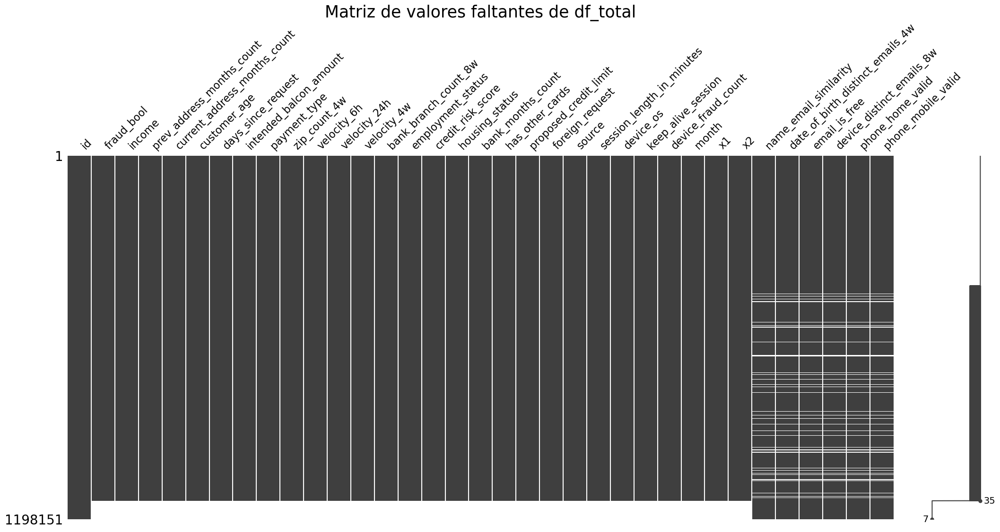

In [24]:
msno.matrix(df_total)
plt.title("Matriz de valores faltantes de df_total", fontsize = 25)
plt.show()

Se observa en la matriz previa que existen varios datos a los que les faltan valores en varias de sus variables. Aún así, aparentemente existen únicamente dos casos posibles:

1. Faltan todos los valores de las columnas originales de los dataframes `df1` y `df2` (sin considerar columna `id`).
2. Faltan todos los valores de las columnas originales del dataframe `df_email_phone` (sin considerar columna `id`).

Los dos casos anteriores dan lugar a dos grupos distintos posibles.  
Ahora se verificará (o rechazará) esta hipótesis:

In [25]:
cols_df_ejemplos = [col for col in df_ejemplos.columns if col != 'id']
cols_df_email_phone = [col for col in df_email_phone.columns if col != 'id']

nulls_group1_any = df_total[df_total[cols_df_ejemplos].isnull().any(axis=1)]
nulls_group1_all = df_total[df_total[cols_df_ejemplos].isnull().all(axis=1)]

nulls_group2_any = df_total[df_total[cols_df_email_phone].isnull().any(axis=1)]
nulls_group2_all = df_total[df_total[cols_df_email_phone].isnull().all(axis=1)]


print("Los DataFrames del grupo 1 son iguales:", nulls_group1_any.equals(nulls_group1_all))
print("Los largos de los dataFrames del grupo 1 son: {} para \'any\' y {} para \'all\'".format(len(nulls_group1_any), len(nulls_group1_all)))
print("Los DataFrames del grupo 2 son iguales:", nulls_group2_any.equals(nulls_group2_all))
print("Los largos de los dataFrames del grupo 2 son: {} para \'any\' y {} para \'all\'".format(len(nulls_group2_any), len(nulls_group2_all)))

Los DataFrames del grupo 1 son iguales: True
Los largos de los dataFrames del grupo 1 son: 60959 para 'any' y 60959 para 'all'
Los DataFrames del grupo 2 son iguales: True
Los largos de los dataFrames del grupo 2 son: 79727 para 'any' y 79727 para 'all'


Con las verificaciones de la celda de código anterior, se puede afirmar que la hpótesis de tener dos grupos de datos faltantes es correcta. Por esto mismo es que se deduce que los datos faltantes se generaron al hacer el `outer merge` de los dataframes de los ejemplos y el de nuevas variables. Estos grupos de datos faltantes se generaron por una de dos opciones:

1. Habían datos en `df_ejemplos` para los que no existía un dato en `df_email_phone` con igual `id`.
2. Habían datos en `df_email_phone` para los que no existía un dato en `df_ejemplos` con igual `id`.

La solución propuesta para los datos faltantes es eliminarlos del dataframe.

### 2.6 Limpiar

Se implementan las soluciones propuestas del ítem previo (eliminar datos duplicados o con valores nulos):

In [26]:
df_t_clean = df_total.dropna()
df_t_clean = df_t_clean.drop_duplicates()

Ahora se verifica que ya no se tengan ni datos duplicados ni datos nulos:

In [27]:
N_dups_df_total = df_t_clean[df_t_clean.duplicated()].shape[0]
N_na_df_total = df_t_clean.isna().sum().sum()
print("El nuevo dataset \'df_t_clean\' resultante después de esta limpieza tiene {} filas".format(len(df_t_clean)))
print("Se borraron {} filas".format(len(df_total) - len(df_t_clean)))
print("Cantidad de duplicados de \'df_t_clean\' : {}".format(N_dups_df_total))
print("Cantidad de nulos de \'df_t_clean\' : {}".format(N_na_df_total))


El nuevo dataset 'df_t_clean' resultante después de esta limpieza tiene 873771 filas
Se borraron 324380 filas
Cantidad de duplicados de 'df_t_clean' : 0
Cantidad de nulos de 'df_t_clean' : 0


### 2.7 Creando columna `segmentacion_etarea`

**Se tienen estas instrucciones:**

7. Realizar una segmentación etaria de los datos creando una columna llamada `segmentacion_etaria` para clasificar a los diferentes usuarios. Para la segmentación utilice los siguientes rangos:
   - Joven (Menor a 18 años)
   - Adulto-Joven (18 - 26 años)
   - Adulto (27- 59 años)
   - Persona Mayor (60 años o mas).

Sin embargo la columna que contiene la información de la edad de los clientes está aproximada a la década más cercana, por lo que para realizar esta transformación habrá que realizar una aproximación equivalente. Por esto, las categoríoas se definen como:

   - Joven (`customer_age` menor o igual a 20)
   - Adulto-Joven (`customer_age` igual a 30)
   - Adulto (`customer_age` igual a 40 o 50)
   - Persona Mayor (`customer_age` mayor o igual a 60).


In [28]:
def asign_segmentacion_etarea(row):
    if row['customer_age'] <= 20:
        return 'Joven'
    elif row['customer_age'] == 30:
        return 'Adulto-Joven'
    elif row['customer_age'] < 60:
        return 'Adulto'
    else:
        return 'Persona Mayor'


df_t_clean['segmentacion_etaria'] = df_t_clean.apply(asign_segmentacion_etarea, axis=1)

Notar que ahora el dataframe tiene una variable (categórica más), o sea, 36 columnas.

## 3. Análisis Exploratorio de Datos

In [29]:
#pip install ydata_profiling

### 3.1 Análisis del EDA

Como ya se saben los tipos de las variables de los  [datos](https://gitlab.com/imezadelajara/datos_proyecto_1_mds7202), al crear el `ProfileReport` para realizar el EDA, se cargan los tipos correctos: 

In [30]:
numerical_vars = [
    'income'  ,
    'name_email_similarity' ,
    'prev_address_months_count' ,
    'current_address_months_count' ,
    'customer_age' ,
    'days_since_request' ,
    'intended_balcon_amount' ,
    'zip_count_4w' ,
    'velocity_6h' ,
    'velocity_24h' ,
    'velocity_4w' ,
    'bank_branch_count_8w' ,
    'date_of_birth_distinct_emails_4w' ,
    'credit_risk_score' ,
    'bank_months_count' ,
    'proposed_credit_limit' ,
    'session_length_in_minutes' ,
    'device_distinct_emails' ,
    'device_fraud_count' ,
    'month' 
]


binary_vars = [
    'fraud_bool' ,
    'keep_alive_session' ,
    'foreign_request' ,
    'has_other_cards' ,
    'phone_mobile_valid' ,
    'phone_home_valid' ,
    'email_is_free' 
]


categorical_vars = [
    'housing_status' ,
    'source' ,
    'payment_type' ,
    'device_os' ,
    'employment_status' ,
    'segmentacion_etaria'
]

vars_types = {}
for var in numerical_vars:
    vars_types[var] = 'Numeric'
for var in binary_vars:
    vars_types[var] = 'Boolean'
for var in categorical_vars:
    vars_types[var] = 'Categorical'

In [31]:
from ydata_profiling import ProfileReport

profile = ProfileReport(df_t_clean, title="EDA", type_schema = vars_types)
profile.to_file("eda.html")

c:\Users\borqu\anaconda3\envs\LabPC\lib\site-packages\numba\core\decorators.py:262: NumbaDeprecationWarning: numba.generated_jit is deprecated. Please see the documentation at: https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-generated-jit for more information and advice on a suitable replacement.
  warnings.warn(msg, NumbaDeprecationWarning)
c:\Users\borqu\anaconda3\envs\LabPC\lib\site-packages\visions\backends\shared\nan_handling.py:51: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def hasna(x: np.ndarray) -> bool:


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

c:\Users\borqu\anaconda3\envs\LabPC\lib\site-packages\ydata_profiling\model\pandas\discretize_pandas.py:52: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  discretized_df.loc[:, column] = self._discretize_column(


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [32]:
profile.to_notebook_iframe()

#### Observaciones

Se tienen 873771 datos con 36 variables.
22 variables son numéricas, 7 categóricas y 7 binarias.
No hay datos nulos ni duplicados.

Los valores de métricas y análisis estadísticos específicos por variable se encuentran en `ProfileReport profile` cargado en las celdas previas y además guardado en el archivo 'eda.html'


A continuación se mencionan relaciones y carcaterísticas interesantes:


1. 'device_fraud_count' tiene el mismo valor **0** para todos los datos, por lo que en realidad no aporta información útil.

2. 'prev_address_months_count' tiene una alta correlación con 'current_address_months_count'	
3. 'customer_age' tiene una alta correlación con 'date_of_birth_distinct_emails_4w'	
4. 'velocity_24h' , 'velocity_4w' y 'month' tienen una alta correlación entre si.	
5. 'bank_branch_count_8w' tiene una alta correlación con 'bank_months_count'.
6. 'credit_risk_score' tiene una alta correlación con 'proposed_credit_limit'.


7. 'fraud_bool' está altamente desbalanceada: el 98.9% de los datos son **0**, siendo **1** solamente el 1.1%
8. 'foreign_request' está altamente desbalanceada: el 97.6% de los datos son **0**, siendo **1** solamente el 2.4%
9. 'source' está altamente desbalanceada: el 99.2% de los datos son **INTERNET**, siendo **TELEAPP** solamente el 0.8%
10. 'device_distinct_emails_8w' está altamente desbalanceada: el 96.4% de los datos son **1.0**, el 2.9% son **2.0** , el 0.7% son **0.0** y menos del 0.1% son **-1.0**

11. 'bank_branch_count_8w': Tomando valores enteros entre 0 y 2404, los valores de mayor frecuencia son **1** con 15% y **0** con 14.2%. El siguiente valor más frecuente es **2** con 5.8%. Todos los demás valores representan un 3% o menos de los datos (c/u).

12. Tanto 'x1' como 'x2' toman valores únicos para cada registro. Ambas variables siguen una **distribución Gaussiana casi perfecta**, con media 0 y desviación estándar 1. Si a esto último se le añade el hecho de que no tienen ninguna correlación aparente, sus nombres no entregan información útil y ademá ninguna de estas variables se menciona ni describe en los [datos originales](https://gitlab.com/imezadelajara/datos_proyecto_1_mds7202), entonces más que razonable suponer que estos valores fueron añadidos a mano, sin que representen ninguna información real sobre los datos.

13. 'prev_address_months_count' toma valores enteros entre -1 y 399. La distribución de los datos es muy desigual entre sus valores, ya que el valor más frecuente es -1, es decir, no se conoce esta información del cliente (dada la información que se maneja sobre esta variable), con una proporción del 76.2% de los datos. Todos los demás valores representan (c/u) menos del 1%.

14. Aunque 'current_address_months_count' puede tomar valores entre -1 y 429, y la desproporción entre valores no es tan extrema como en el caso de 'prev_address_months_count', si es posible corroborar el hecho de que la mayor parte de los datos se concentran en valores inferiores a 150, es más: El tercer quintil (75% de los datos) está justamente en el valor 154. 

15. La variable categórica 'payment_type' está muy desbalanceada. Teniendo 5 clases, casi el 40% es 'AB', mientras que menos del 0.1% es 'AE', las demás categorías y sus proporciones del total de datos son: 'AA'	con	24.9%, 'AC'	con 24.7% y 'AD' con 10.4%.

16. La variable categórica 'employment_status' está muy desbalanceada. Teniendo 7 clases, casi el 68.5% es 'CA', mientras que menos del 0.1% es 'CG', las demás categorías y sus proporciones del total de datos son: 'CB' con 13.5%, 'CC' con 8.9%, 'CF' con 4.5%,'CD' con 2.7% y 'CE' con 1.9%


17. La variable categórica 'housing_status' está muy desbalanceada. Teniendo 7 categorías, la más común ('BC') representa el 33.5% de los datos, mientras que la menos común 'BG' es menos del 0.1% de los mismos.

18. 'bank_months_count': Tomando valores enteros entre -1 y 32, los valores de mayor frecuencia son **-1** con 24.7% y **1** con 18.0%. Todos los demás valores tienen menos de un 8.2% de los datos.

19. 'device_os' tiene 3 categorías que están considerablemente balanceadas entre sí: 'linux', 'windows' y 'other' representan aproximadamente el 30% de los datos c/u; mientras que las clases 'macintosh' y 'x11' son el 5% y 0.8% de los datos respectivamente.

20. Otras variables desbalanceadas son 'device_distinct_emails_8w' y 'phone_mobile_valid'.

21. Las variables binarias más balanceadas (diferencia entre una categoría y otra de 12% o menos del total de datos) son: 'keep_alive_session', 'email_is_free', 'phone_home_valid'.

22. La variable `segmnentacion_etarea` tiene un desbalance significativo en favor de la categoría 'Adulto' (con 52.9%). Las demás clases están relativamente balanceadas entre si: Adulto-Joven	(18.8%), Joven (16.0%) y Persona Mayor (12.2%).

#### Outliers y caracterizaciones numéricas

In [33]:
skews = []
kurts = []
vars_to_analize_distrib = [
    'income',
    'name_email_similarity',
    'prev_address_months_count',
    'current_address_months_count',
    'customer_age',
    'days_since_request',
    'intended_balcon_amount',
    'zip_count_4w',
    'velocity_6h',
    'velocity_24h',
    'velocity_4w',
    'bank_branch_count_8w',
    'date_of_birth_distinct_emails_4w',
    'credit_risk_score',
    'bank_months_count',
    'proposed_credit_limit',
    'session_length_in_minutes',
    'x1',
    'x2'
]
for var in vars_to_analize_distrib:
    skews.append(df_t_clean.loc[:, var].skew().round(2))
    kurts.append(df_t_clean.loc[:, var].kurt().round(2))
    
skews_ord = sorted(skews, reverse=True)
vars_ord_skew = [vars_to_analize_distrib[i] for i in sorted(range(len(skews)), key=lambda k: skews[k], reverse=True)]

kurts = sorted(kurts, reverse=True)
vars_ord_kurts = [vars_to_analize_distrib[i] for i in sorted(range(len(kurts)), key=lambda k: kurts[k], reverse=True)]

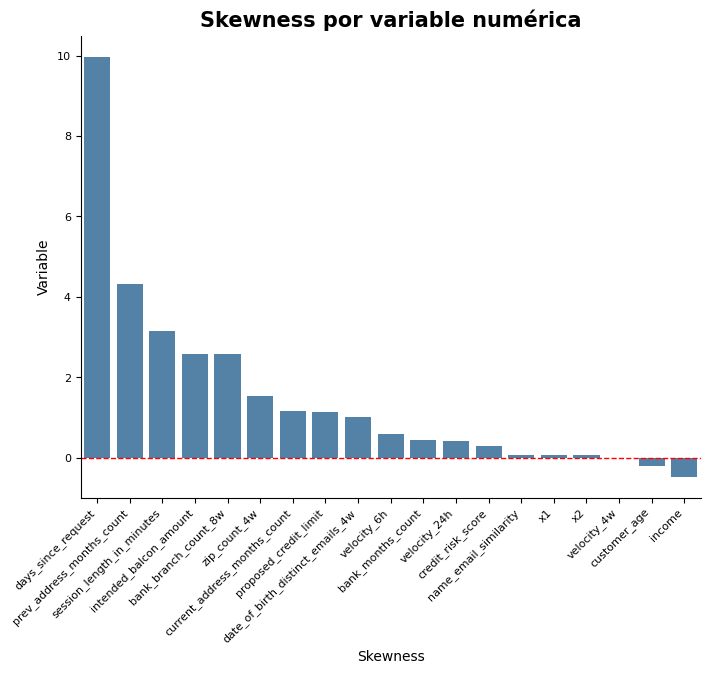

In [34]:
plt.figure(figsize=(8, 6)) 

ax = sns.barplot(x=vars_ord_skew, y=skews_ord, color='SteelBlue')  
ax.set_ylabel('Variable', fontsize=10)  
ax.set_xlabel('Skewness', fontsize=10)  
ax.tick_params(axis='both', labelsize=8)  
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=8)  
ax.axhline(y=0, color='red', linestyle='--', linewidth=1)
ax.set_title('Skewness por variable numérica', ha = 'center', weight='bold', fontsize=15)
sns.despine()
plt.gca().set_facecolor('white') 
plt.show()

De las skewness mostradas, se deduce que la únicas variables considerablemente simétricas (skewness entre -0.2 y 0.2) serían 'name_email_similarity', 'x1', 'x2', 'velocity_4w' y 'customer_age'. 

La única variable con skewness inferior a -0.2 es income con -0.47. Por lo que es la única que se considera desequilibrada hacia la derecha del gráfico.

Todas las demás variables son desbalanceadas hacia la izquierda de sus respectivos gráficos de distribución. Las más asimétricas en este sentido son: 'days_since_request', 'prev_address_months_count', 'session_length_in_minutes', 'intended_balcon_amount' y 'bank_branch_count_8w'con skewness de 9.98, 4.32, 3.15, 2.59 y  2.57 respectivamente.


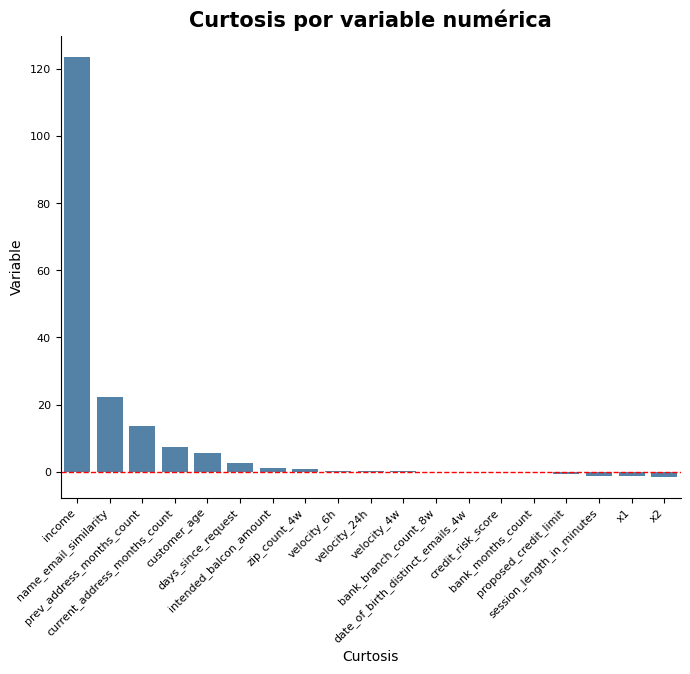

In [35]:
plt.figure(figsize=(8, 6)) 

ax = sns.barplot(x=vars_ord_kurts, y=kurts, color='SteelBlue')  
ax.set_ylabel('Variable', fontsize=10)  
ax.set_xlabel('Curtosis', fontsize=10)  
ax.tick_params(axis='both', labelsize=8)  
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=8)  
ax.axhline(y=0, color='red', linestyle='--', linewidth=1)
ax.set_title('Curtosis por variable numérica', ha = 'center', weight='bold', fontsize=15)
sns.despine()
plt.gca().set_facecolor('white') 
plt.show()

Definitivamente la variable que más destaca en el estudi de curtosis es 'income', dado que es la variable con el valor de curtosis (significativamente) mayor que las demás. Su curtosis es superior a 120, lo que indica una alta concentración de valores en torno a la media con más valores extremos en la distribución. 

Las demás variables con curtosis positiva, por lo que siguen distribución Leptocúrtica, son (en orden descendente): 'name_email_similarity','prev_address_months_count','current_address_months_count','customer_age','days_since_request','intended_balcon_amount' y 'zip_count_4w'. 

Las variables con curtosis 0, por lo que siguen una distribución Mesocúrtica, son: 'velocity_6h','velocity_24h','velocity_4w', bank_branch_count_8w','date_of_birth_distinct_emails_4w','credit_risk_score','bank_months_count' y'proposed_credit_limit'.

Finalmente, las variables con curtosis menor a 0, por lo que siguen distribución Platicúrtica son: 'session_length_in_minutes', 'x1' y 'x2'.

Ahora se procede a graficar histogramas con boxplots y outliers:

In [36]:
import plotly.express as px
import plotly.offline as pyo
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [37]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def plot_hist_bxp_outliers(dataframe, var):
    
    fig, (ax1, ax2) = plt.subplots(nrows=2, ncols=1, figsize=(4, 4))

    
    sns.histplot(data=dataframe, x=var, ax=ax1)
    ax1.set_title('Histograma de {}'.format(var))

    
    sns.boxplot(data=dataframe, x=var, ax=ax2)
    ax2.set_title('Boxplot de {}'.format(var))
    
    q1 = dataframe[var].quantile(0.25)
    q3 = dataframe[var].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = dataframe[(dataframe[var] < lower_bound) | (dataframe[var] > upper_bound)]
    num_outliers = len(outliers)
    outlier_values = outliers[var].values

    
    print("Cantidad de outliers de variable {} : {}".format(var,num_outliers))
    
    plt.tight_layout()
    plt.show()

    return outlier_values

Cantidad de outliers de variable income : 0


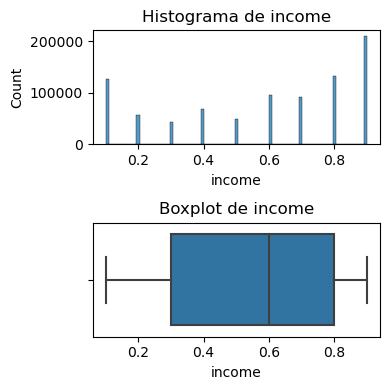

Cantidad de outliers de variable name_email_similarity : 0


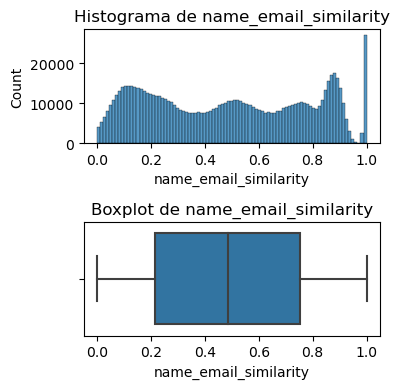

Cantidad de outliers de variable prev_address_months_count : 207787


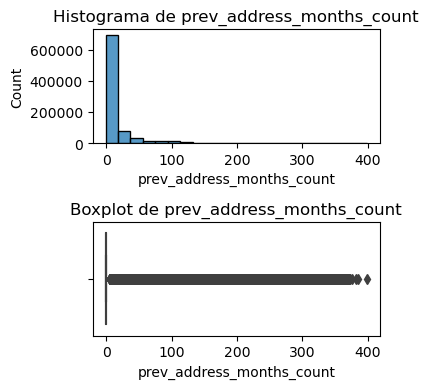

Cantidad de outliers de variable current_address_months_count : 28615


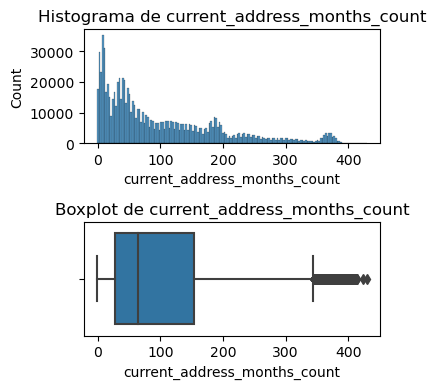

Cantidad de outliers de variable customer_age : 242


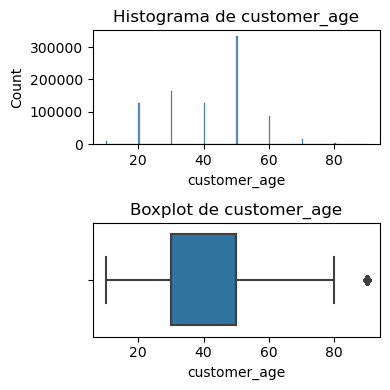

Cantidad de outliers de variable days_since_request : 79375


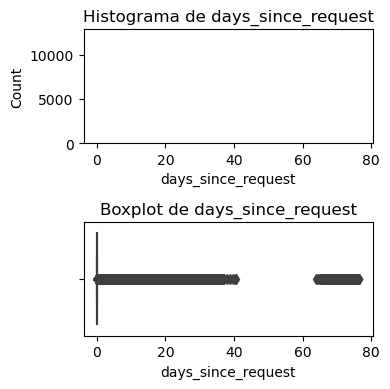

Cantidad de outliers de variable intended_balcon_amount : 216155


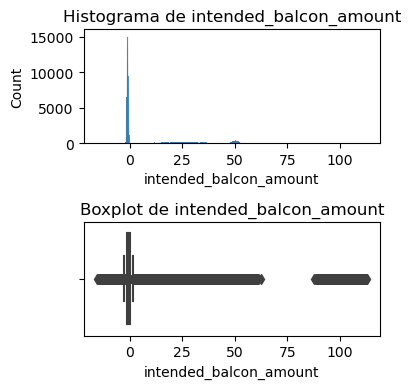

Cantidad de outliers de variable zip_count_4w : 59121


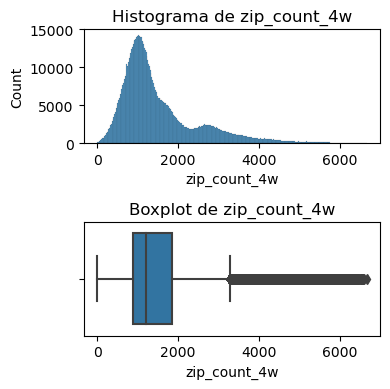

Cantidad de outliers de variable velocity_6h : 11059


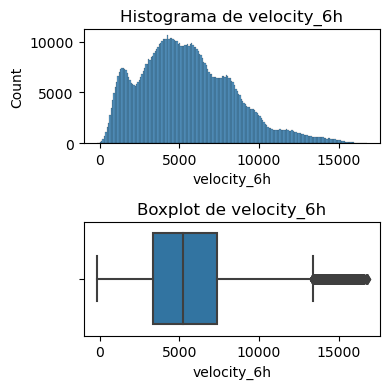

Cantidad de outliers de variable velocity_24h : 6815


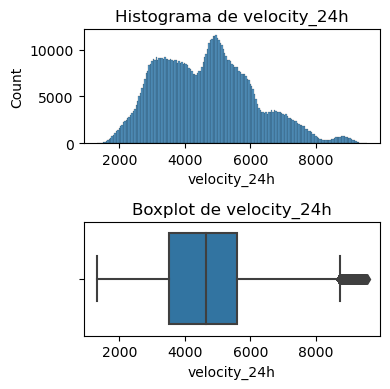

Cantidad de outliers de variable velocity_4w : 2


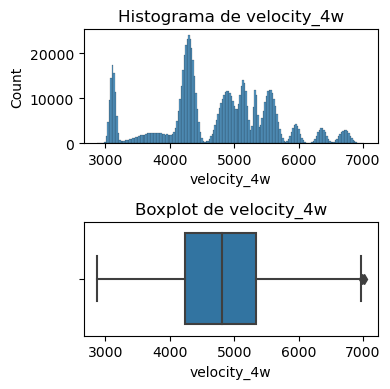

Cantidad de outliers de variable bank_branch_count_8w : 167548


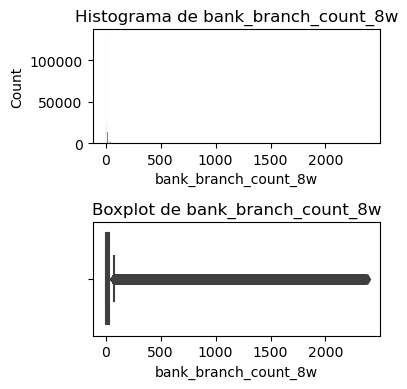

Cantidad de outliers de variable date_of_birth_distinct_emails_4w : 10511


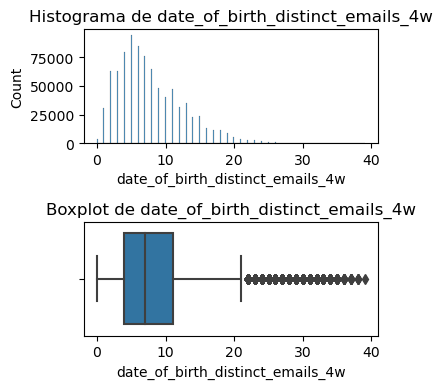

Cantidad de outliers de variable credit_risk_score : 5842


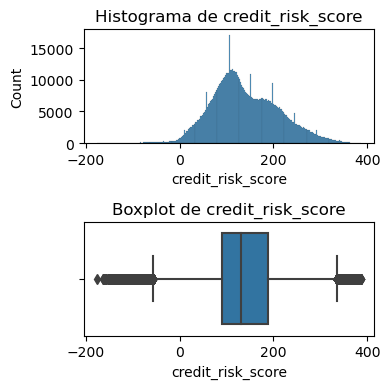

Cantidad de outliers de variable bank_months_count : 0


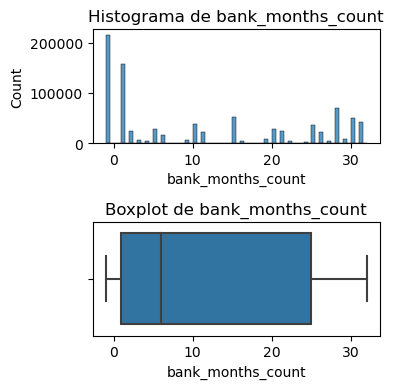

Cantidad de outliers de variable proposed_credit_limit : 0


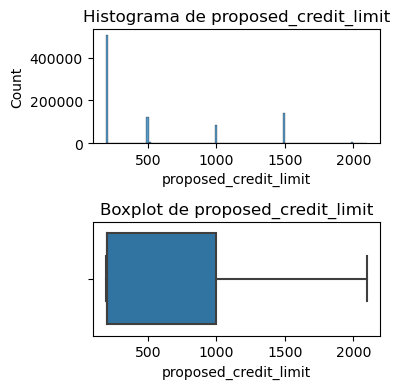

Cantidad de outliers de variable session_length_in_minutes : 64479


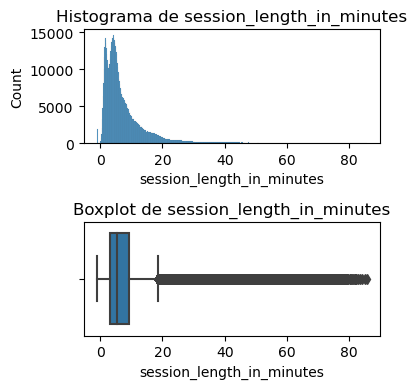

Cantidad de outliers de variable x1 : 7528


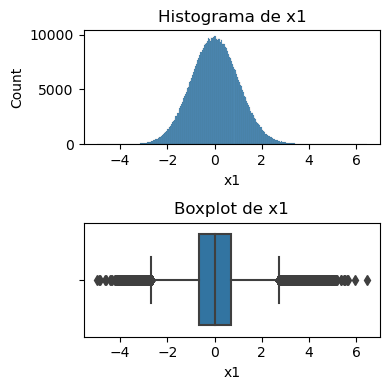

Cantidad de outliers de variable x2 : 7413


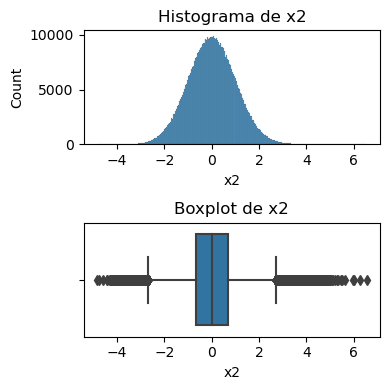

In [38]:
outliers_per_var = {}
for var in vars_to_analize_distrib:
    outliers_per_var[var] = plot_hist_bxp_outliers(df_t_clean, var)

In [39]:
def plot_boxplots_per_class(data_frame, features, class_column, ncols=4, figsize=(10, 18)):
    nrows = (len(features) + ncols - 1) // ncols  # Calcula el número de filas necesarias
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
    
    for i, feature in enumerate(features):
        ax = axes[i // ncols, i % ncols]  # Obtiene el subplot correspondiente
        
        classes = data_frame[class_column].unique()
        colors = ['lightblue', 'lightgreen']  # Colores para cada clase

        for j, class_val in enumerate(classes):
            subset = data_frame[data_frame[class_column] == class_val][feature]
            ax.boxplot(subset, positions=[j+1], patch_artist=True, 
                       boxprops=dict(facecolor=colors[j], color='black'),
                       flierprops=dict(marker='o', markersize=5, markerfacecolor=colors[j], markeredgecolor='black'),
                       medianprops=dict(color='black'),
                       whiskerprops=dict(color='black'),
                       capprops=dict(color='black')
                      )

        ax.set_xticks(range(1, len(classes) + 1))
        ax.set_xticklabels(classes)
        ax.set_xlabel(class_column)        
        ax.set_title(feature)
    
    # Eliminar subplots no utilizados
    for i in range(len(features), nrows * ncols):
        fig.delaxes(axes.flatten()[i])
    
    plt.tight_layout()
    plt.show()

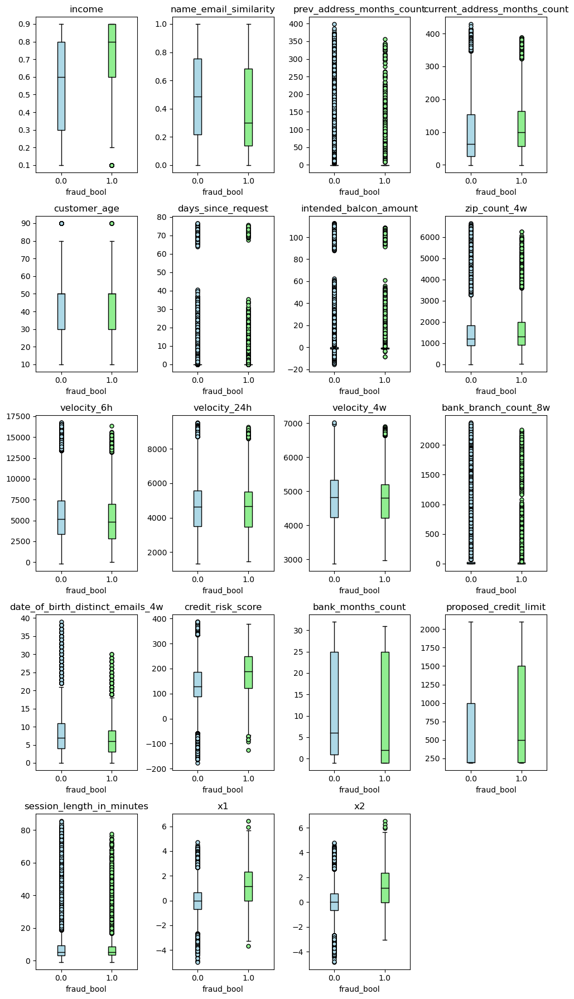

In [40]:
plot_boxplots_per_class(df_t_clean, vars_to_analize_distrib, 'fraud_bool')

Con todos los gráficos que se han mostrado hasta ahora, es claro que hay muchas variables qu tienen muchos outliers (bank_branch_count_8w con 167548 o intended_balcon_amount con 216155 son solo algunos ejemplos.). Si bien es cierto, existen varias variables para las que sus distribuciones y outliers se parecen entre aquellos casos positivos y negativos para `fraud_bool` (por ejemplo 'bank_branch_coun_8w' o 'customer_age'); existen otras variables en las que estos comportamientos de outliers y distribuciones son muy distintos según el valor de `fraud_bool` (por ejemplo 'x2' o 'credit_risk_score'). Si además se considera el hecho de que hay muy pocos datos de `fraud_bool = 1`, se opta por no eliminar los outliers, ya que estos pueden contener información útil para decidir si se trata o no de un fraude. Para reducir el efecto que tendrán los outliers a posteriori, se propone una transformación logarítmica previa a una normalización de valores.

## 4. Preprocesamiento

### 4.1 Declarar `ColumnTransformer`

In [41]:
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler, MinMaxScaler, PowerTransformer, FunctionTransformer
import numpy as np

In [42]:
numerical_vars_pp = [
    'income'  ,
    'prev_address_months_count' ,
    'current_address_months_count' ,
    'customer_age' ,
    'days_since_request' ,
    'intended_balcon_amount' ,
    'zip_count_4w' ,
    'velocity_6h' ,
    'velocity_24h' ,
    'velocity_4w' ,
    'bank_branch_count_8w' ,
    'credit_risk_score' ,
    'bank_months_count' ,
    'proposed_credit_limit' ,
    'session_length_in_minutes' ,
    'device_fraud_count' ,
    'x1',
    'x2',
    'name_email_similarity' ,
    'date_of_birth_distinct_emails_4w' , 
]

categorical_vars_pp = [
    'payment_type' ,
    'employment_status' ,
    'housing_status' ,
    'has_other_cards' ,
    'foreign_request' ,
    'source' ,    
    'device_os' ,
    'keep_alive_session' ,
    'month', #Notar que se ha decidido tratar los meses de manera categórica en lugar de numérica
    'email_is_free',
    'segmentacion_etaria',
    'device_distinct_emails_8w' ,
    'phone_mobile_valid' ,
    'phone_home_valid' ,
]


In [43]:
from sklearn import set_config

set_config(transform_output="pandas")

In [44]:
def log_transform(X):
    return np.log(X + np.abs(np.min(X))+1)

TreatOutliers_pip = Pipeline([    
    ('log_transform', FunctionTransformer(log_transform, validate=False)),
    ('scaler', MinMaxScaler())
])

preprocessing_transformer = ColumnTransformer(
    transformers=[
        ('passthrough', 'passthrough', ['id', 'fraud_bool']),
        ('OneHotEncoder', OneHotEncoder(sparse = False),  categorical_vars_pp),
        ('NumericalTransform', TreatOutliers_pip, numerical_vars_pp), 
        ])

### 4.2 Transformar datos

In [45]:
df_preprocesado = preprocessing_transformer.fit_transform(df_t_clean)
df_preprocesado


c:\Users\borqu\anaconda3\envs\LabPC\lib\site-packages\sklearn\preprocessing\_encoders.py:868: FutureWarning:

`sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.

c:\Users\borqu\anaconda3\envs\LabPC\lib\site-packages\numpy\core\fromnumeric.py:84: FutureWarning:

In a future version, DataFrame.min(axis=None) will return a scalar min over the entire DataFrame. To retain the old behavior, use 'frame.min(axis=0)' or just 'frame.min()'



,passthrough__id,passthrough__fraud_bool,OneHotEncoder__payment_type_AA,OneHotEncoder__payment_type_AB,OneHotEncoder__payment_type_AC,OneHotEncoder__payment_type_AD,OneHotEncoder__payment_type_AE,OneHotEncoder__employment_status_CA,OneHotEncoder__employment_status_CB,OneHotEncoder__employment_status_CC,...,NumericalTransform__bank_branch_count_8w,NumericalTransform__credit_risk_score,NumericalTransform__bank_months_count,NumericalTransform__proposed_credit_limit,NumericalTransform__session_length_in_minutes,NumericalTransform__device_fraud_count,NumericalTransform__x1,NumericalTransform__x2,NumericalTransform__name_email_similarity,NumericalTransform__date_of_birth_distinct_emails_4w
0,729517,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.089162,0.912732,0.000000,0.331861,0.533412,0.0,0.693265,0.738506,0.913405,0.297817
2,149585,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.949510,0.890895,0.679992,0.014442,0.423787,0.0,0.710528,0.525144,0.154723,0.436295
4,64486,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.371799,0.939877,0.311543,0.830726,0.389976,0.0,0.835759,0.701220,0.842212,0.436295
5,825283,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.871099,0.908301,0.456402,0.014442,0.355919,0.0,0.696814,0.756216,0.899239,0.650034
7,8308,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,...,0.089162,0.893659,0.000000,0.014442,0.325286,0.0,0.501579,0.725037,0.536077,0.715409
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1137187,707063,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.141319,0.930182,0.876553,0.635331,0.458718,0.0,0.735493,0.694516,0.903129,0.375804
1137188,784606,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.230481,0.926666,0.934628,0.014442,0.375374,0.0,0.809950,0.544281,0.130556,0.485719
1137189,216375,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.308450,0.942713,0.964506,0.830726,0.429321,0.0,0.658386,0.580052,0.523086,0.715409
1137190,41856,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.296190,0.900101,0.803438,0.014442,0.355319,0.0,0.806288,0.699792,0.535067,0.751607


In [46]:
df_preprocesado = pd.DataFrame(df_preprocesado)
df_preprocesado

,passthrough__id,passthrough__fraud_bool,OneHotEncoder__payment_type_AA,OneHotEncoder__payment_type_AB,OneHotEncoder__payment_type_AC,OneHotEncoder__payment_type_AD,OneHotEncoder__payment_type_AE,OneHotEncoder__employment_status_CA,OneHotEncoder__employment_status_CB,OneHotEncoder__employment_status_CC,...,NumericalTransform__bank_branch_count_8w,NumericalTransform__credit_risk_score,NumericalTransform__bank_months_count,NumericalTransform__proposed_credit_limit,NumericalTransform__session_length_in_minutes,NumericalTransform__device_fraud_count,NumericalTransform__x1,NumericalTransform__x2,NumericalTransform__name_email_similarity,NumericalTransform__date_of_birth_distinct_emails_4w
0,729517,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.089162,0.912732,0.000000,0.331861,0.533412,0.0,0.693265,0.738506,0.913405,0.297817
2,149585,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.949510,0.890895,0.679992,0.014442,0.423787,0.0,0.710528,0.525144,0.154723,0.436295
4,64486,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.371799,0.939877,0.311543,0.830726,0.389976,0.0,0.835759,0.701220,0.842212,0.436295
5,825283,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.871099,0.908301,0.456402,0.014442,0.355919,0.0,0.696814,0.756216,0.899239,0.650034
7,8308,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,...,0.089162,0.893659,0.000000,0.014442,0.325286,0.0,0.501579,0.725037,0.536077,0.715409
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1137187,707063,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.141319,0.930182,0.876553,0.635331,0.458718,0.0,0.735493,0.694516,0.903129,0.375804
1137188,784606,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.230481,0.926666,0.934628,0.014442,0.375374,0.0,0.809950,0.544281,0.130556,0.485719
1137189,216375,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.308450,0.942713,0.964506,0.830726,0.429321,0.0,0.658386,0.580052,0.523086,0.715409
1137190,41856,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.296190,0.900101,0.803438,0.014442,0.355319,0.0,0.806288,0.699792,0.535067,0.751607


## 5. Visualización en Baja Dimensionalidad

In [47]:
from sklearn.manifold import TSNE

def plot_low_dim(dataframe, plot = True):
    tsne = TSNE(n_components=2, random_state=42)
    df_features_embedded = tsne.fit_transform(dataframe)
    dataframe["x_tsne"] = df_features_embedded[:, 0]
    dataframe["y_tsne"] = df_features_embedded[:, 1]

    px.scatter(dataframe, x="x_tsne", y="y_tsne") 

In [48]:
sampleX = df_preprocesado.sample(25000)
sampleY = sampleX.iloc[:, :2]
sampleX = sampleX.iloc[:, 2:]
sampleX

,OneHotEncoder__payment_type_AA,OneHotEncoder__payment_type_AB,OneHotEncoder__payment_type_AC,OneHotEncoder__payment_type_AD,OneHotEncoder__payment_type_AE,OneHotEncoder__employment_status_CA,OneHotEncoder__employment_status_CB,OneHotEncoder__employment_status_CC,OneHotEncoder__employment_status_CD,OneHotEncoder__employment_status_CE,...,NumericalTransform__bank_branch_count_8w,NumericalTransform__credit_risk_score,NumericalTransform__bank_months_count,NumericalTransform__proposed_credit_limit,NumericalTransform__session_length_in_minutes,NumericalTransform__device_fraud_count,NumericalTransform__x1,NumericalTransform__x2,NumericalTransform__name_email_similarity,NumericalTransform__date_of_birth_distinct_emails_4w
407827,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.000000,0.915619,0.000000,0.331861,0.312756,0.0,0.796300,0.601346,0.013820,0.375804
1043591,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.727551,0.835324,0.311543,0.014442,0.589275,0.0,0.754597,0.757429,0.798446,0.751607
30629,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.638389,0.917515,0.876553,0.331861,0.551157,0.0,0.713400,0.663278,0.823226,0.650034
258495,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.548324,0.923069,0.934628,0.830726,0.494163,0.0,0.729830,0.874024,0.107815,0.563705
399678,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.000000,0.893110,0.000000,0.014442,0.234477,0.0,0.703829,0.727661,0.042496,0.563705
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106416,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.934579,0.878124,0.727364,0.014442,0.378657,0.0,0.723742,0.600406,0.319649,0.650034
957273,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.141319,0.902709,0.311543,0.635331,0.337400,0.0,0.779295,0.766252,0.929501,0.485719
146569,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.089162,0.923069,0.000000,0.331861,0.421714,0.0,0.797669,0.695589,0.275509,0.527507
893167,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.385352,0.818610,0.964506,0.014442,0.324123,0.0,0.690463,0.776026,0.034861,0.624196


In [49]:
sampleY

,passthrough__id,passthrough__fraud_bool
407827,750018,0.0
1043591,227440,0.0
30629,997978,0.0
258495,929901,0.0
399678,132938,0.0
...,...,...
106416,865175,0.0
957273,603381,0.0
146569,346891,0.0
893167,697546,0.0


In [50]:
plot_low_dim(sampleX)

In [51]:
px.scatter(sampleX, x="x_tsne", y="y_tsne", title= "Visualización baja dimensionalidad con TSNE de todos los datos muestreados")


In [52]:
def scatter_per_age_group(dataframe, var, title, class_col):
    
    df_filtered = dataframe[dataframe[var] == 1]
    
    fig = px.scatter(df_filtered, x='x_tsne', y='y_tsne', color=class_col,
                     title= title,
                     color_discrete_map={0: 'blue', 1: 'red'})
    
    fig.show()

In [53]:
sampleX['fraud_bool'] = sampleY['passthrough__fraud_bool']
title = "Visualización baja dimensionalidad con TSNE de segmentación etarea Joven"
scatter_per_age_group(sampleX, 'OneHotEncoder__segmentacion_etaria_Joven', title, 'fraud_bool')

In [54]:
title = "Visualización baja dimensionalidad con TSNE de segmentación etarea Adulto-Joven"
scatter_per_age_group(sampleX, 'OneHotEncoder__segmentacion_etaria_Adulto-Joven', title, 'fraud_bool')

In [55]:
title = "Visualización baja dimensionalidad con TSNE de segmentación etarea Adulto"
scatter_per_age_group(sampleX, 'OneHotEncoder__segmentacion_etaria_Adulto', title,  'fraud_bool')

In [56]:
title = "Visualización baja dimensionalidad con TSNE de segmentación etarea Persona Mayor"
scatter_per_age_group(sampleX, 'OneHotEncoder__segmentacion_etaria_Persona Mayor', title, 'fraud_bool')

**Observaciones**
1. Tanto las visualizaciones de los grupos etáreos de *Joven* y *Adulto-Joven* muestran concentraciones evidentes, en cuanto a la cercanía, de sus datos en esta representación 2D. A pesar de esto, ambos gráficos muestran varios datos dispersos.
2. Los puntos del grupo etáreo Adulto son los más concentrados de todos los gráficos. Aunque no se pueden formar grupos claramente definidos y diferenciados entre sellos, sí se puede notar que los puntos tienden a estar mucho más cerca unos de otros (Si se compara con los demás gráficos).
3. El gráfico de Personas mayores también muestra concentraciones de puntos (más a la derecha del gráfico), sin embargo es también el gráfico que (proporcionalmente) muestra una mayor cantidad de datos dispersos.
4. No es posible notar un patrón claro que permita agrupar y diferenciar los puntos que representan fraudes (color amarillo).

## 6. Anomalías


### Detectando anomalías/fraudes

Como sí se conocen las clases correctas de cada instancia ('fraud_bool') y además se tiene una cantidad adecuada de datos, se puede implementar un detector con aprendizaje supervisado, se propone usar clasificador de árbol de decisión en esta instancia. El motivo de esto es simplemente por su velicidad de ajuste y su buen desempeño general en problemas de clasificación binaria (como este) como para servir de línea base para futuros modelos. 

El enunciado establece que esto se haga por segmentación etaria; antes de hacerlo así, primero se probará un único clasificador sobre todos los datos en conjunto. Esto permitirá una comparación *a posteriori* y evaluar si se justifica o no la segmentación o no.

#### Sin segmentar

In [57]:
from sklearn.model_selection import train_test_split

X = df_preprocesado.drop(['passthrough__id', 'passthrough__fraud_bool'], axis=1)
y = df_preprocesado['passthrough__fraud_bool']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

In [58]:
from sklearn.tree import DecisionTreeClassifier

model = DecisionTreeClassifier()
model.fit(X_train, y_train)
y_pred = model.predict(X_val)

TP = np.unique(y_val.values + y_pred, return_counts=True)[1][2]
pred_T = np.unique(y_pred, return_counts=True)[1][1]
true_T = np.unique(y_val.values, return_counts=True)[1][1]

print("Sin segmentar clase etaria")
print("Verdaderos positivos : {}".format(TP))
print("Predichos Fraude : {}".format(pred_T))
print("Realmente Fraude : {}".format(true_T))
print("Ratio P : {}".format(TP/pred_T))
print("Ratio R : {}".format(TP/true_T))

Sin segmentar clase etaria
Verdaderos positivos : 698
Predichos Fraude : 2156
Realmente Fraude : 1990
Ratio P : 0.323747680890538
Ratio R : 0.3507537688442211


#### Segmentación para Joven

In [59]:
df_preprocesado_joven = df_preprocesado[df_preprocesado['OneHotEncoder__segmentacion_etaria_Joven'] == 1]

XJ = df_preprocesado_joven.drop(['passthrough__id', 'passthrough__fraud_bool'], axis=1)
yj = df_preprocesado_joven['passthrough__fraud_bool']

X_trainJ, X_valJ, y_trainj, y_valj = train_test_split(XJ, yj, test_size=0.2, random_state=42)

model = DecisionTreeClassifier()
model.fit(X_trainJ, y_trainj)
y_predj = model.predict(X_valJ)


TP = np.unique(y_valj.values + y_predj, return_counts=True)[1][2]
pred_T = np.unique(y_predj, return_counts=True)[1][1]
true_T = np.unique(y_valj.values, return_counts=True)[1][1]

print("Clase etaria Joven")
print("verdaderos positivos : {}".format(TP))
print("Predichos Fraude : {}".format(pred_T))
print("Realmente Fraude : {}".format(true_T))
print("Ratio P : {}".format(TP/pred_T))
print("Ratio R : {}".format(TP/true_T))

Clase etaria Joven
verdaderos positivos : 116
Predichos Fraude : 184
Realmente Fraude : 192
Ratio P : 0.6304347826086957
Ratio R : 0.6041666666666666


#### Segmentación para Adulto-Joven

In [60]:
df_preprocesado_Adjoven = df_preprocesado[df_preprocesado['OneHotEncoder__segmentacion_etaria_Adulto-Joven'] == 1]

XAJ = df_preprocesado_Adjoven.drop(['passthrough__id', 'passthrough__fraud_bool'], axis=1)
yaj = df_preprocesado_Adjoven['passthrough__fraud_bool']

X_trainAJ, X_valAJ, y_trainaj, y_valaj = train_test_split(XAJ, yaj, test_size=0.2, random_state=42)

model = DecisionTreeClassifier()
model.fit(X_trainAJ, y_trainaj)
y_predaj = model.predict(X_valAJ)



TP = np.unique(y_valaj.values + y_predaj, return_counts=True)[1][2]
pred_T = np.unique(y_predaj, return_counts=True)[1][1]
true_T = np.unique(y_valaj.values, return_counts=True)[1][1]

print("Clase etaria Adulto Joven")
print("verdaderos positivos : {}".format(TP))
print("Predichos Fraude : {}".format(pred_T))
print("Realmente Fraude : {}".format(true_T))
print("Ratio P : {}".format(TP/pred_T))
print("Ratio R : {}".format(TP/true_T))

Clase etaria Adulto Joven
verdaderos positivos : 240
Predichos Fraude : 401
Realmente Fraude : 382
Ratio P : 0.5985037406483791
Ratio R : 0.6282722513089005


#### Segmentación para Adulto

In [61]:
df_preprocesado_Ad = df_preprocesado[df_preprocesado['OneHotEncoder__segmentacion_etaria_Adulto'] == 1]

XA = df_preprocesado_Ad.drop(['passthrough__id', 'passthrough__fraud_bool'], axis=1)
ya = df_preprocesado_Ad['passthrough__fraud_bool']

X_trainA, X_valA, y_traina, y_vala = train_test_split(XA, ya, test_size=0.2, random_state=42)

model = DecisionTreeClassifier()
model.fit(X_trainA, y_traina)
y_preda = model.predict(X_valA)


TP = np.unique(y_vala.values + y_preda, return_counts=True)[1][2]
pred_T = np.unique(y_preda, return_counts=True)[1][1]
true_T = np.unique(y_vala.values, return_counts=True)[1][1]

print("Clase etaria Adulto")
print("verdaderos positivos : {}".format(TP))
print("Predichos Fraude : {}".format(pred_T))
print("Realmente Fraude : {}".format(true_T))
print("Ratio P : {}".format(TP/pred_T))
print("Ratio R : {}".format(TP/true_T))

Clase etaria Adulto
verdaderos positivos : 297
Predichos Fraude : 1218
Realmente Fraude : 1009
Ratio P : 0.2438423645320197
Ratio R : 0.2943508424182359


#### Segmentación para Persona Mayor

In [62]:
df_preprocesado_M = df_preprocesado[df_preprocesado['OneHotEncoder__segmentacion_etaria_Persona Mayor'] == 1]

XM = df_preprocesado_M.drop(['passthrough__id', 'passthrough__fraud_bool'], axis=1)
ym = df_preprocesado_M['passthrough__fraud_bool']

X_trainM, X_valM, y_trainm, y_valm = train_test_split(XM, ym, test_size=0.2, random_state=42)

model = DecisionTreeClassifier()
model.fit(X_trainM, y_trainm)
y_predm = model.predict(X_valM)


TP = np.unique(y_valm.values + y_predm, return_counts=True)[1][2]
pred_T = np.unique(y_predm, return_counts=True)[1][1]
true_T = np.unique(y_valm.values, return_counts=True)[1][1]

print("Clase etaria Persona Mayor")
print("verdaderos positivos : {}".format(TP))
print("Predichos Fraude : {}".format(pred_T))
print("Realmente Fraude : {}".format(true_T))
print("Ratio P : {}".format(TP/pred_T))
print("Ratio R : {}".format(TP/true_T))

Clase etaria Persona Mayor
verdaderos positivos : 35
Predichos Fraude : 447
Realmente Fraude : 348
Ratio P : 0.07829977628635347
Ratio R : 0.10057471264367816


### Comentarios


**¿Qué ratios?**

Las ratios pedidas **P** y **R** son la *precision* y la *recall* respectivamente. 

La *precision* es una métrica que busca maximizar los verdaderos positivos a la vez que minimizar los falsos positivos, notar que si se hubiese predicho únicamente un caso como fraude y ese hubiese sido correcto, esta métrica valdría 1. En síntesis, una alta *precisión* indica que hay menos falsos positivos.

La *recall* es una métrica que busca maximizar los verdaderos positivos a la vez que minimizar los falsos negativos, notar que si todos los casos son clasificados como fraude, esta métrica valdía 1. En síntesis, una alta *recall* indica que hay menos falsos negativos.

Naturalmente, ninguna de estas métricas debe priorizarse por sí sola, ya que existe un *trade-off* entre ellas y los únicos problemas que pueden permitirse ignorar completamente ambas métricas son problemas triviales no dignos de estudio. un así, hay muchos casos en los que es más importante priorizar una métrica por sobre otra, en este caso por ejemplo, es más importante la *recall* que la *precision*, ya que así se podrían impedir más fraudes (incluso si eso conlleva más carga o problemas para transacciones no fraudulentas).

**Lo que dicen los ratios calculados :**

En primer lugar, es claro notar que el modelo en los grupos etarios de 'Joven' y 'Adulto-Joven' se desempeña significativamente mejor que en los de 'Adulto' y 'Persona Mayor'. En los primeros grupos se alcanzan ratios de 0.6 o más de manera consistente, mientras que para los últimos dos grupos, se tienen ratios de P ~ 0.24, R ~ 0.29 y P ~ 0.06, R ~ 0.07 respectivamente. 

Por otro lado, las mismas ratios alcanzan valores P ~ 0.31, R ~ 0.35 cuando no se hace ninguna segmentación etaria.

Por todo lo anterior es que el uso de la segmentación es considerada un beneficio o no dependiendo del grupo etario de mayor interés.

**¿Aceptable o no?**

Como se dijo con anterioridad, no todos los grupos etarios tienen igual desempeño, y aunque los dos menores indican resultados muy prometedores, sigue siendo razonable esperar mejores resultados de los actuales tanto para Adultos como para Personas mayores. Esto porque hay ciertas consideraciones que hay que hacer:

1. Los datos estaban muy desbalanceados. En entrenamientos futuros esto se tratará con *oversampling* o con *data augmentation*

2. No se buscaron mejores hiperparámetros de entrenamiento (lo que sí se hará a futuro), se usaron los que implementa por defecto `DecisionTreeClassifier`.

3. Solamente se probó un tipo de clasificador. A futuro se probarán otros algoritmos.

4. Es claro que sí es posible abordar este problema con algoritmos de *Machine Learning* (recordar métricas de 'Joven' y 'Adulto-Joven'). 

5. Se considera posible (habrá que probar) aplicar *Transfer Learning*, de modo que primero el algoritmo/modelo destinado al grupo etario **J**, se ajuste/entrene a todos los demás grupos **antes** de ajustarse/entrenarse exclisivamente con **J**.

